In [6]:
%matplotlib inline
import seaborn
import numpy as np, scipy, matplotlib.pyplot as plt, sklearn, librosa, mir_eval, urllib, IPython.display, pandas
plt.rcParams['figure.figsize'] = (14,5)

## Vallenato

In [7]:
filename_brahms = 'Alejandro Duran - Alicia adorada.mp3'
x_vallenato01, fs_vallenato01 = librosa.load(filename_brahms, duration=120)

In [8]:
IPython.display.Audio(x_vallenato01, rate=fs_vallenato01)

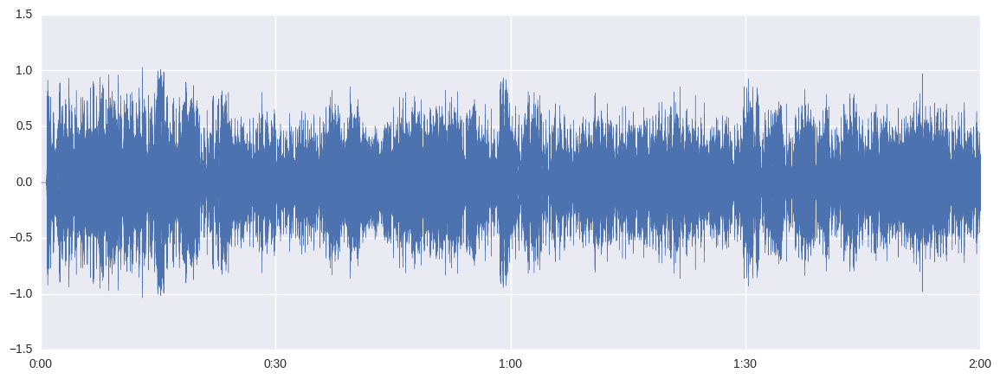

In [9]:
librosa.display.waveplot(x_vallenato01, fs_vallenato01)

In [53]:
features = np.array([])
centroid = librosa.feature.spectral_centroid(x_vallenato01, sr=fs_vallenato01)
mean_centroid = np.mean(centroid.reshape(5168))
features = np.append(features,mean_centroid)
rolloff = librosa.feature.spectral_rolloff(x_vallenato01, sr=fs_vallenato01)
mean_rolloff = np.mean(rolloff.reshape(5168))
features = np.append(features,mean_rolloff)
zero_crossing = librosa.feature.zero_crossing_rate(x_vallenato01)
mean_zero_crossing = np.mean(zero_crossing.reshape(5168))
features = np.append(features,mean_zero_crossing)

[  2.86240520e+03   5.80337532e+03   1.45576595e-01]


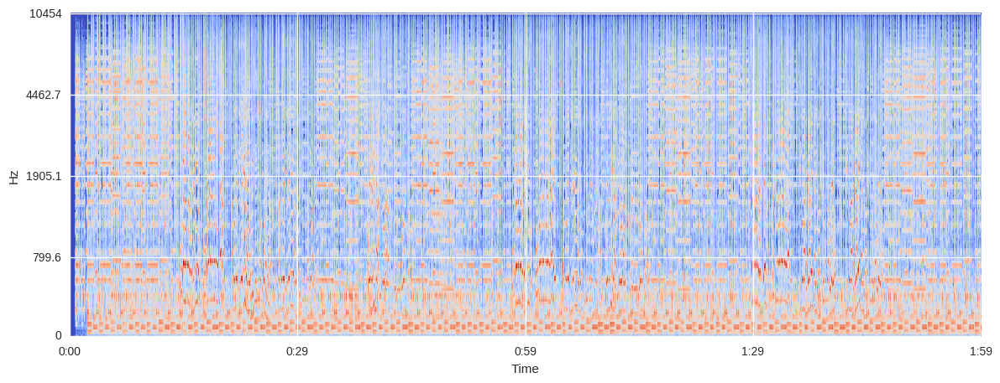

In [6]:
librosa.display.specshow(S_log_vallenato01, fs_vallenato01, x_axis='time', y_axis='mel')

In [7]:
n_mfcc = 12
mfcc_vallenato01 = librosa.feature.mfcc(x_vallenato01, sr=fs_vallenato01, n_mfcc=n_mfcc).T
mfcc_vallenato01.shape

(5168, 12)

In [8]:
scaler = sklearn.preprocessing.StandardScaler()
mfcc_vallenato_scaled = scaler.fit_transform(mfcc_vallenato01)

In [9]:
mfcc_vallenato_scaled.mean(axis=0)

array([ -8.24933517e-17,  -1.09991136e-16,   1.09991136e-17,
         3.84968974e-17,   4.39964542e-17,  -1.78735595e-16,
        -1.53987590e-16,  -3.16224515e-17,   2.74977839e-18,
         7.69937949e-17,   6.04951246e-17,  -4.39964542e-17])

In [10]:
mfcc_vallenato_scaled.std(axis=0)

array([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.])

## Bambuco

In [17]:
filename_bambuco = 'A bordo de tu voz - Luz Marina Posada.mp3'
x_bambuco01, fs_bambuco01 = librosa.load(filename_bambuco, duration=120)

In [18]:
IPython.display.Audio(x_bambuco01, rate=fs_bambuco01)

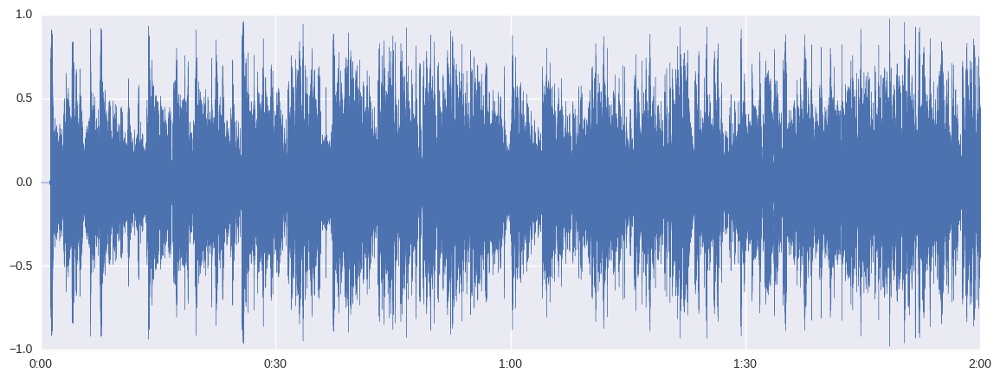

In [19]:
librosa.display.waveplot(x_bambuco01, fs_bambuco01)

In [20]:
S_bambuco01 = librosa.feature.melspectrogram(x_bambuco01, fs_bambuco01)
S_log_bambuco01 = librosa.logamplitude(S_bambuco01)

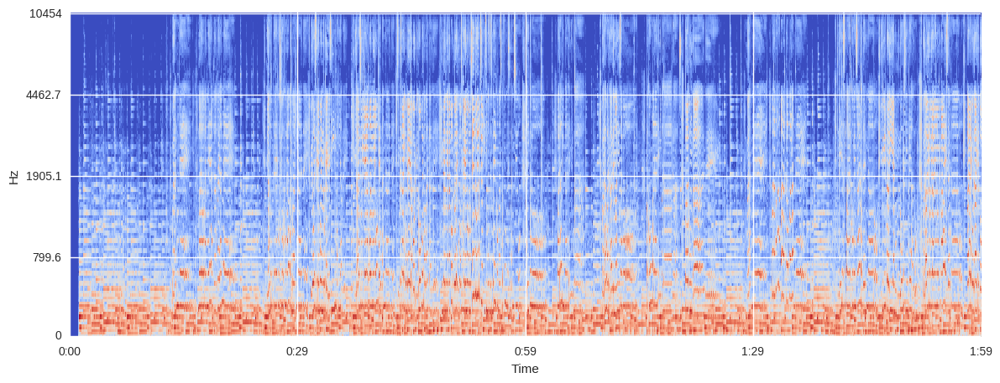

In [21]:
librosa.display.specshow(S_log_bambuco01, fs_bambuco01, x_axis='time', y_axis='mel')

In [22]:
mfcc_bambuco01 = librosa.feature.mfcc(x_bambuco01, sr=fs_bambuco01, n_mfcc=n_mfcc).T
mfcc_bambuco01.shape

(5168, 12)

In [23]:
mfcc_bambuco_scaled = scaler.fit_transform(mfcc_bambuco01)

In [24]:
mfcc_bambuco_scaled.mean(axis=0)

array([  2.14482714e-16,  -3.02475623e-16,  -1.09991136e-16,
        -1.64986703e-17,   2.08983158e-16,   3.29973407e-17,
         1.53987590e-16,   1.09991136e-17,  -6.59946813e-17,
         0.00000000e+00,  -5.49955678e-17,  -1.64986703e-17])

In [25]:
mfcc_bambuco_scaled.std(axis=0)

array([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.])

In [39]:
vallenato_train = mfcc_bambuco_scaled.reshape(5168*12)
bambuco_train = mfcc_bambuco_scaled.reshape(5168*12)

In [38]:
print(bambuco_train)


[-3.95994    -3.86927286 -1.27959571 ...,  1.53708928 -1.91562434
 -0.28905398]


In [40]:
features = numpy.vstack((vallenato_train, bambuco_train))
features.shape

(2, 62016)

In [41]:
labels = numpy.array([[0],[1]])
print(labels.shape)

(2, 1)


In [42]:
model = sklearn.linear_model.Perceptron()
model.fit(features, labels)


/home/oscarnanez/anaconda3/lib/python3.5/site-packages/sklearn/utils/validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Perceptron(alpha=0.0001, class_weight=None, eta0=1.0, fit_intercept=True,
      n_iter=5, n_jobs=1, penalty=None, random_state=0, shuffle=True,
      verbose=0, warm_start=False)

## TEST

In [53]:
filename_test = '03 cuanto te vayas - los inquietos.mp3'
x_test, fs_test = librosa.load(filename_test, duration=120)

In [54]:
IPython.display.Audio(x_test, rate=fs_test)

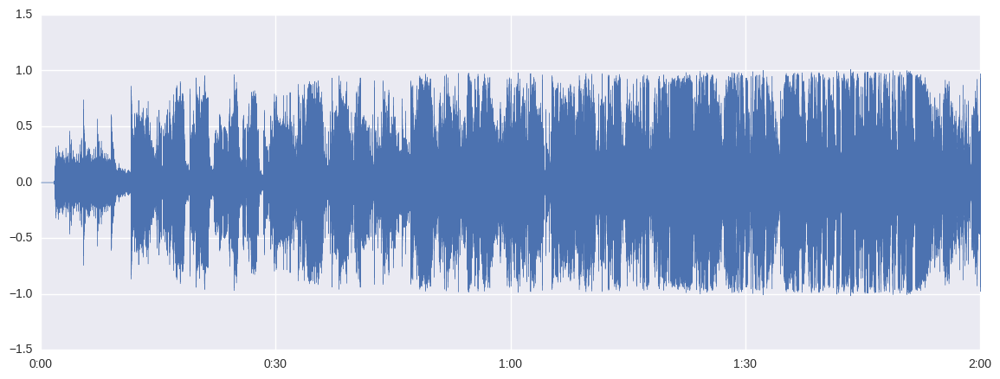

In [55]:
librosa.display.waveplot(x_test, fs_test)

In [59]:
S_test = librosa.feature.melspectrogram(x_test, fs_test)
S_log_test = librosa.logamplitude(S_test)

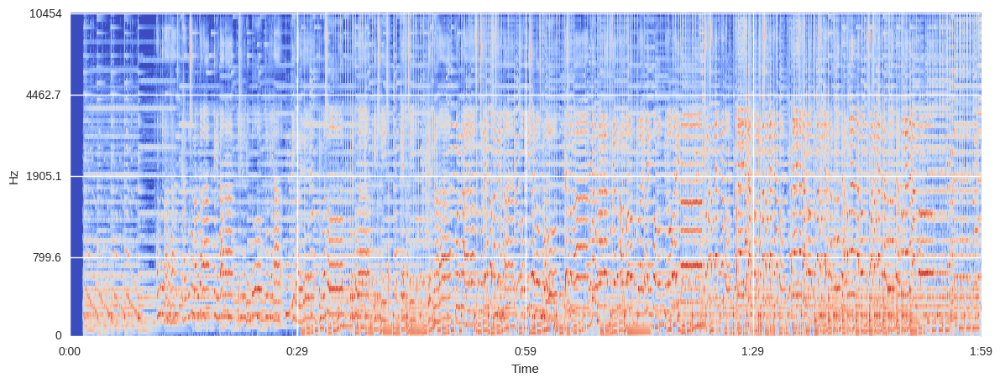

In [60]:
librosa.display.specshow(S_log_test, fs_test, x_axis='time', y_axis='mel')

In [61]:
mfcc_test = librosa.feature.mfcc(x_test, sr=fs_test, n_mfcc=n_mfcc).T
mfcc_test.shape

(5168, 12)

In [66]:
mfcc_test_scaled = scaler.transform(mfcc_test)
test_01 = mfcc_test_scaled.reshape(5168*12)

In [50]:
features_test = mfcc_test_scaled

In [71]:
labels_test = numpy.array([0])

In [69]:
predicted_labels = model.predict(test_01)

/home/oscarnanez/anaconda3/lib/python3.5/site-packages/sklearn/utils/validation.py:386: DeprecationWarning: Passing 1d arrays as data is deprecated in 0.17 and willraise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.
  DeprecationWarning)


In [72]:
predicted_labels

array([0])

In [74]:
score = model.score(test_01, labels_test)

/home/oscarnanez/anaconda3/lib/python3.5/site-packages/sklearn/utils/validation.py:386: DeprecationWarning: Passing 1d arrays as data is deprecated in 0.17 and willraise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.
  DeprecationWarning)


In [75]:
score

1.0

## TEST 2

In [12]:
filename_test2 = 'Atardecer Pasillo Colombia.mp3'
x_test2, fs_test2 = librosa.load(filename_test2, duration=60)

In [24]:
IPython.display.Audio(x_test2, rate=fs_test2)

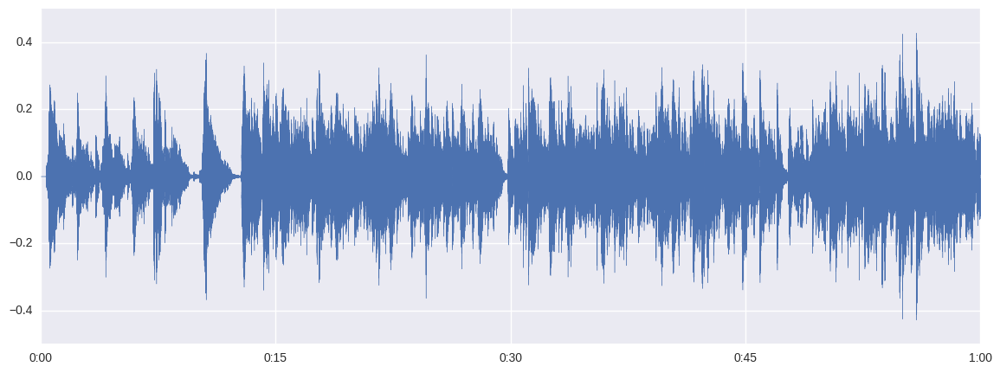

In [26]:
librosa.display.waveplot(x_test2, fs_test2)

In [27]:
S_test2 = librosa.feature.melspectrogram(x_test2, fs_test2)
S_log_test2 = librosa.logamplitude(S_test2)

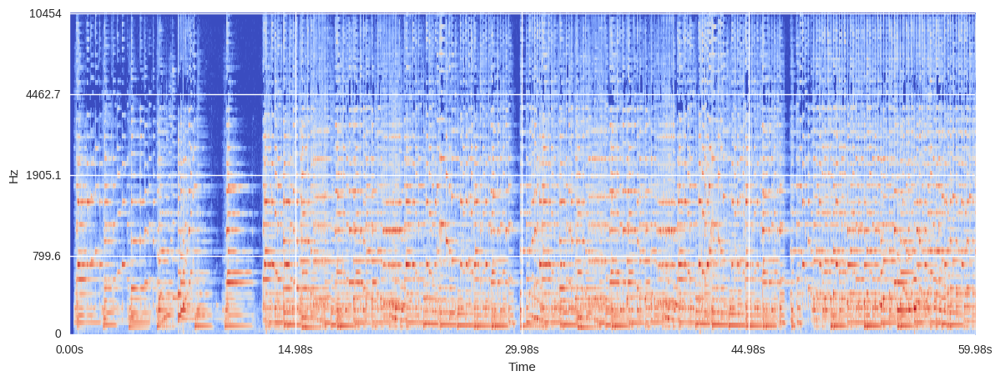

In [28]:
librosa.display.specshow(S_log_test2, fs_test2, x_axis='time', y_axis='mel')

In [29]:
mfcc_test2 = librosa.feature.mfcc(x_test2, sr=fs_test2, n_mfcc=n_mfcc).T
mfcc_test2.shape

(2584, 12)

In [30]:
mfcc_test2_scaled = scaler.transform(mfcc_test2)

In [31]:
features_test2 = mfcc_test2_scaled

In [32]:
labels_test2 = numpy.ones(len(mfcc_test2))

In [33]:
predicted_labels2 = model.predict(features_test2)

In [34]:
score2 = model.score(features_test2, labels_test2)

In [35]:
score2

0.30688854489164086

## TEST 3

In [13]:
filename_test3 = 'El mejoral - Alejo Duran.mp3'
x_test3, fs_test3 = librosa.load(filename_test3, duration=60)

In [152]:
IPython.display.Audio(x_test3, rate=fs_test3)

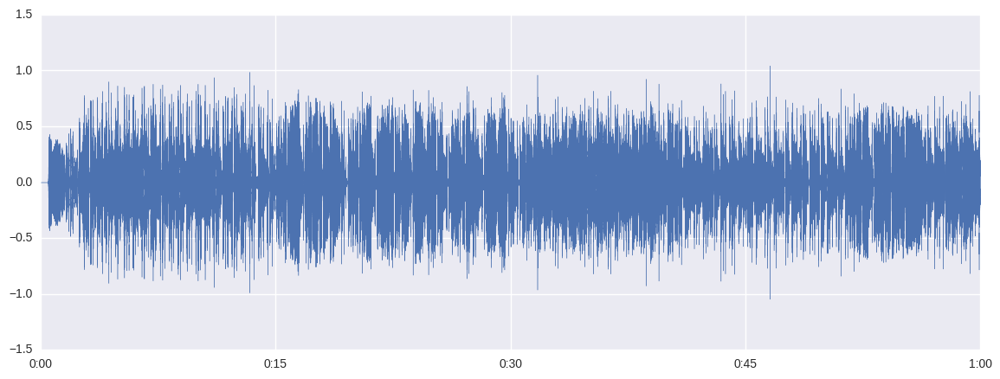

In [153]:
librosa.display.waveplot(x_test3, fs_test3)

In [154]:
S_test3 = librosa.feature.melspectrogram(x_test3, fs_test3)
S_log_test3 = librosa.logamplitude(S_test3)

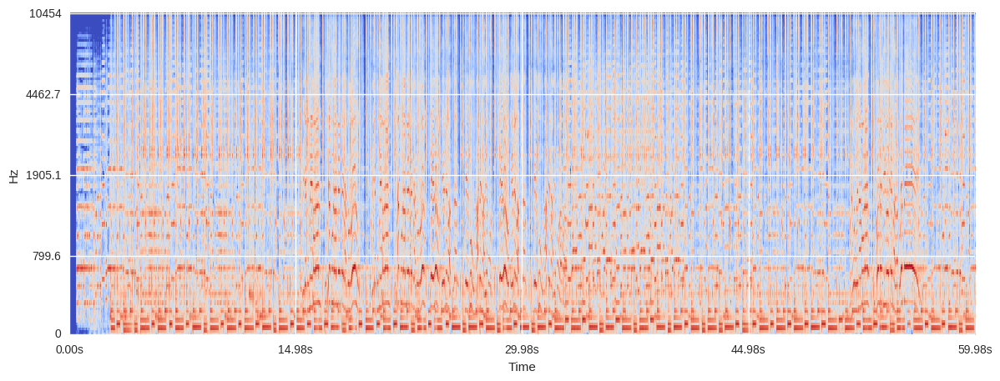

In [155]:
librosa.display.specshow(S_log_test3, fs_test3, x_axis='time', y_axis='mel')

In [156]:
mfcc_test3 = librosa.feature.mfcc(x_test3, sr=fs_test3, n_mfcc=n_mfcc).T
mfcc_test3.shape

(2584, 12)

In [180]:
mfcc_test3_scaled = scaler.transform(mfcc_test3)

In [181]:
features_test3 = mfcc_test3_scaled

In [182]:
labels_test3 = numpy.zeros(len(mfcc_test3))

In [183]:
predicted_labels3 = model.predict(features_test3)

In [184]:
score3 = model.score(features_test3, labels_test3)

In [185]:
score3

0.65441176470588236

In [193]:
print(predicted_labels3[:500])

[ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  0.
  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  0.  1.  1

In [17]:
chroma_vallenato01 = librosa.feature.chroma_cens(x_vallenato01, sr=fs_vallenato01)
chroma_bambuco01 = librosa.feature.chroma_cens(x_bambuco01, sr=fs_bambuco01)
chroma_test01 = librosa.feature.chroma_cens(x_test, sr=fs_test)
chroma_test02 = librosa.feature.chroma_cens(x_test2, sr=fs_test2)
chroma_test03 = librosa.feature.chroma_cens(x_test3, sr=fs_test3)

/home/oscarnanez/anaconda3/lib/python3.5/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)
/home/oscarnanez/anaconda3/lib/python3.5/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)
/home/oscarnanez/anaconda3/lib/python3.5/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)
/home/oscarnanez/anaconda3/lib/python3.5/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)
/home/oscarnanez

In [26]:
sz = chroma_vallenato01.shape[1]
print(chroma_vallenato01.sum(axis=1)/sz)

[ 0.17693018  0.27264343  0.28068334  0.25135729  0.15185648  0.11401762
  0.09123995  0.10777537  0.27758011  0.39367644  0.36507678  0.2351123 ]


In [27]:
sz = chroma_bambuco01.shape[1]
print(chroma_bambuco01.sum(axis=1)/sz)

[ 0.24633115  0.29157858  0.27084388  0.28947181  0.29345959  0.2158653
  0.11669257  0.12467278  0.25912307  0.28700061  0.20110667  0.15334579]


In [29]:
sz = chroma_test01.shape[1]
print(chroma_test01.sum(axis=1)/sz)

[ 0.26743889  0.14445204  0.13326756  0.21987638  0.23613644  0.21815862
  0.20034212  0.24075872  0.29386403  0.26571273  0.28371061  0.30892367]


In [31]:
sz = chroma_test02.shape[1]
print(chroma_test02.sum(axis=1)/sz)

[ 0.21171215  0.29118664  0.31242809  0.20432504  0.14108181  0.14748691
  0.20689068  0.25169194  0.30443424  0.33265338  0.29049521  0.18128286]


In [28]:
sz = chroma_test03.shape[1]
print(chroma_test03.sum(axis=1)/sz)

[ 0.31199557  0.26772434  0.14267526  0.13317238  0.32561582  0.38902111
  0.3808605   0.22493746  0.17144883  0.09867847  0.10539261  0.20073144]
